# Kualitas Udara SVM dan Logistic Regression 

Dataset ini memuat informasi tentang Indeks Standar Pencemar Udara (ISPU) yang diukur di lima stasiun pemantau kualitas udara (SPKU) di Provinsi DKI Jakarta dari tahun 2016 hingga tahun 2020.

Variabel yang terdapat dalam dataset ini dijelaskan sebagai berikut:

- tanggal: Tanggal ketika pengukuran kualitas udara dilakukan.
- stasiun: Lokasi pengukuran di stasiun pemantau kualitas udara.
- pm10: Partikulat Matter dengan diameter kurang dari 10 mikrometer. Ini mencakup partikel-partikel kecil yang dapat terhirup oleh manusia dan memasuki saluran pernapasan.
- so2: Sulfur Dioksida, gas yang dihasilkan dari pembakaran bahan bakar fosil, dapat menyebabkan iritasi pada saluran pernapasan.
- co: Carbon Monoxide, gas beracun yang dihasilkan dari pembakaran tidak sempurna bahan bakar.
- o3: Ozon, gas yang dapat menyebabkan iritasi pada saluran pernapasan dan mempengaruhi kualitas udara di tingkat permukaan.
- no2: Nitrogen Dioksida, gas yang dihasilkan dari pembakaran bahan bakar fosil dan dapat berdampak buruk pada kesehatan manusia.
- max: Nilai tertinggi dari seluruh parameter yang diukur dalam waktu yang sama.
- critical: Parameter yang memiliki hasil pengukuran tertinggi pada saat pengukuran.
- categori: Kategori hasil perhitungan Indeks Standar Pencemaran Udara (ISPU), yang mencerminkan tingkat pencemaran udara pada waktu tertentu.


Dataset ini dapat digunakan untuk menganalisis tren kualitas udara, mengidentifikasi stasiun dengan tingkat pencemaran tertinggi, dan memahami dampak parameter-parameter tertentu terhadap indeks pencemaran udara.

# Import Library

In [1]:
# Import library dataframe
import numpy as np 
from numpy import mean 
import pandas as pd 

# Import library untuk visualisasi
import matplotlib.pyplot as plt 
%matplotlib inline
import seaborn as sns
import folium

# Initialize the map

# Import library untuk preprocessing 
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler 
from sklearn import preprocessing 
from sklearn.model_selection import train_test_split 

# Mengatur display agar maximal
pd.options.display.max_rows = None
pd.options.display.max_columns = None

# Import library untuk modelling/analysis
from sklearn import metrics
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score 
from sklearn.metrics import confusion_matrix 
from sklearn.metrics import classification_report 
from sklearn.metrics import mean_squared_error 
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import BaggingClassifier
from sklearn.multiclass import OneVsRestClassifier
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import roc_auc_score


# Oversample and plot imbalanced dataset with SMOTE
from collections import Counter
from matplotlib import pyplot
from numpy import where

# Import library untuk balancing data
from imblearn.over_sampling import SMOTE

# Import library untuk model improvement
from sklearn.model_selection import GridSearchCV
from sklearn.datasets import make_classification
from sklearn.model_selection import cross_val_score

# Import Library untuk balancing
from sklearn.utils import resample

# Import library untuk mengabaikan peringatan
import warnings
warnings.filterwarnings("ignore")

print('Import Library Berhasil dilakukan ^_^')

Import Library Berhasil dilakukan ^_^


# Data Loading

In [2]:
df2016 = pd.read_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/ISPU 2016/combined_data16new.csv')
df2017 = pd.read_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/ISPU 2017/combined_data17new.csv')
df2018 = pd.read_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/ISPU 2018/combined_data18new.csv')
df2019 = pd.read_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/ISPU 2019/combined_data19new.csv')
df2020 = pd.read_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/ISPU 2020/combined_data20new.csv')

Menampilkan seluruh data setiap taun

In [3]:
df2016

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2016-01-01,DKI1 (Bunderan HI),59.0,19.0,27.0,31.0,1.0,59,PM10,SEDANG
1,2016-01-02,DKI1 (Bunderan HI),52.0,19.0,26.0,33.0,2.0,52,PM10,SEDANG
2,2016-01-03,DKI1 (Bunderan HI),44.0,19.0,26.0,36.0,2.0,44,PM10,BAIK
3,2016-01-04,DKI1 (Bunderan HI),58.0,21.0,26.0,46.0,5.0,58,PM10,SEDANG
4,2016-01-05,DKI1 (Bunderan HI),70.0,19.0,26.0,41.0,4.0,70,PM10,SEDANG
5,2016-01-06,DKI1 (Bunderan HI),69.0,19.0,26.0,19.0,4.0,69,PM10,SEDANG
6,2016-01-07,DKI1 (Bunderan HI),58.0,19.0,26.0,25.0,3.0,58,PM10,SEDANG
7,2016-01-08,DKI1 (Bunderan HI),46.0,24.0,26.0,54.0,3.0,46,PM10,BAIK
8,2016-01-09,DKI1 (Bunderan HI),51.0,32.0,26.0,54.0,2.0,51,PM10,SEDANG
9,2016-01-10,DKI1 (Bunderan HI),59.0,39.0,26.0,43.0,3.0,59,PM10,SEDANG


In [4]:
df2017

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2017-01-01,DKI1 (Bunderan HI),63.0,34.0,25.0,21.0,2.0,63.0,PM10,SEDANG
1,2017-01-02,DKI1 (Bunderan HI),16.0,32.0,16.0,19.0,1.0,32.0,SO2,BAIK
2,2017-01-03,DKI1 (Bunderan HI),18.0,32.0,17.0,20.0,2.0,32.0,SO2,BAIK
3,2017-01-04,DKI1 (Bunderan HI),24.0,32.0,22.0,20.0,2.0,32.0,SO2,BAIK
4,2017-01-05,DKI1 (Bunderan HI),29.0,32.0,25.0,14.0,2.0,32.0,SO2,BAIK
5,2017-01-06,DKI1 (Bunderan HI),21.0,31.0,24.0,18.0,2.0,31.0,SO2,BAIK
6,2017-01-07,DKI1 (Bunderan HI),30.0,32.0,22.0,17.0,3.0,32.0,SO2,BAIK
7,2017-01-08,DKI1 (Bunderan HI),29.0,33.0,17.0,19.0,2.0,33.0,SO2,BAIK
8,2017-01-09,DKI1 (Bunderan HI),29.0,32.0,23.0,13.0,2.0,32.0,SO2,BAIK
9,2017-01-10,DKI1 (Bunderan HI),38.0,32.0,34.0,21.0,4.0,38.0,PM10,BAIK


In [5]:
df2018

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2018-01-01,DKI1 (Bunderan HI),35.0,20.0,22.0,27.0,2.0,35.0,PM10,BAIK
1,2018-01-02,DKI1 (Bunderan HI),14.0,18.0,12.0,17.0,1.0,18.0,SO2,BAIK
2,2018-01-04,DKI1 (Bunderan HI),24.0,21.0,20.0,19.0,2.0,24.0,PM10,BAIK
3,2018-01-05,DKI1 (Bunderan HI),23.0,19.0,17.0,21.0,2.0,23.0,PM10,BAIK
4,2018-01-06,DKI1 (Bunderan HI),18.0,19.0,14.0,24.0,2.0,24.0,O3,BAIK
5,2018-01-07,DKI1 (Bunderan HI),21.0,20.0,14.0,27.0,2.0,27.0,O3,BAIK
6,2018-01-08,DKI1 (Bunderan HI),48.0,27.0,19.0,44.0,3.0,48.0,PM10,BAIK
7,2018-01-09,DKI1 (Bunderan HI),24.0,23.0,16.0,29.0,2.0,29.0,O3,BAIK
8,2018-01-10,DKI1 (Bunderan HI),28.0,23.0,16.0,44.0,3.0,44.0,O3,BAIK
9,2018-01-11,DKI1 (Bunderan HI),40.0,30.0,18.0,36.0,4.0,40.0,PM10,BAIK


In [6]:
df2019

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2019-01-01,DKI1 (Bunderan HI),29.0,15.0,5.0,75.0,13.0,29,PM10,BAIK
1,2019-01-02,DKI1 (Bunderan HI),24.0,17.0,5.0,75.0,6.0,24,PM10,BAIK
2,2019-01-03,DKI1 (Bunderan HI),16.0,16.0,5.0,29.0,4.0,29,O3,BAIK
3,2019-01-04,DKI1 (Bunderan HI),38.0,18.0,8.0,24.0,10.0,38,PM10,BAIK
4,2019-01-05,DKI1 (Bunderan HI),37.0,29.0,16.0,75.0,16.0,37,PM10,BAIK
5,2019-01-06,DKI1 (Bunderan HI),66.0,34.0,30.0,75.0,27.0,66,PM10,SEDANG
6,2019-01-07,DKI1 (Bunderan HI),52.0,47.0,14.0,75.0,25.0,52,PM10,SEDANG
7,2019-01-08,DKI1 (Bunderan HI),36.0,16.0,25.0,89.0,10.0,89,O3,SEDANG
8,2019-01-09,DKI1 (Bunderan HI),61.0,15.0,28.0,198.0,8.0,198,O3,TIDAK SEHAT
9,2019-01-10,DKI1 (Bunderan HI),41.0,13.0,26.0,128.0,8.0,128,O3,TIDAK SEHAT


In [7]:
df2020

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2020-01-01,DKI1 (Bunderan HI),30.0,20.0,10.0,32.0,9.0,32.0,O3,BAIK
1,2020-01-02,DKI1 (Bunderan HI),27.0,22.0,12.0,29.0,8.0,29.0,O3,BAIK
2,2020-01-03,DKI1 (Bunderan HI),39.0,22.0,14.0,32.0,10.0,39.0,PM10,BAIK
3,2020-01-04,DKI1 (Bunderan HI),34.0,22.0,14.0,38.0,10.0,38.0,O3,BAIK
4,2020-01-05,DKI1 (Bunderan HI),35.0,22.0,12.0,31.0,9.0,35.0,PM10,BAIK
5,2020-01-06,DKI1 (Bunderan HI),46.0,23.0,16.0,32.0,9.0,46.0,PM10,BAIK
6,2020-01-07,DKI1 (Bunderan HI),37.0,23.0,26.0,33.0,11.0,37.0,PM10,BAIK
7,2020-01-08,DKI1 (Bunderan HI),41.0,26.0,20.0,30.0,11.0,41.0,PM10,BAIK
8,2020-01-09,DKI1 (Bunderan HI),52.0,23.0,29.0,24.0,12.0,52.0,PM10,SEDANG
9,2020-01-10,DKI1 (Bunderan HI),24.0,24.0,18.0,25.0,8.0,25.0,O3,BAIK


Menggabungkan data

In [8]:
dfs = [df2016, df2017, df2018, df2019, df2020]

df = pd.concat(dfs, ignore_index=True)

Menampilkan seluruh data ketika sudah digabung

In [9]:
df

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2016-01-01,DKI1 (Bunderan HI),59.0,19.0,27.0,31.0,1.0,59.0,PM10,SEDANG
1,2016-01-02,DKI1 (Bunderan HI),52.0,19.0,26.0,33.0,2.0,52.0,PM10,SEDANG
2,2016-01-03,DKI1 (Bunderan HI),44.0,19.0,26.0,36.0,2.0,44.0,PM10,BAIK
3,2016-01-04,DKI1 (Bunderan HI),58.0,21.0,26.0,46.0,5.0,58.0,PM10,SEDANG
4,2016-01-05,DKI1 (Bunderan HI),70.0,19.0,26.0,41.0,4.0,70.0,PM10,SEDANG
5,2016-01-06,DKI1 (Bunderan HI),69.0,19.0,26.0,19.0,4.0,69.0,PM10,SEDANG
6,2016-01-07,DKI1 (Bunderan HI),58.0,19.0,26.0,25.0,3.0,58.0,PM10,SEDANG
7,2016-01-08,DKI1 (Bunderan HI),46.0,24.0,26.0,54.0,3.0,46.0,PM10,BAIK
8,2016-01-09,DKI1 (Bunderan HI),51.0,32.0,26.0,54.0,2.0,51.0,PM10,SEDANG
9,2016-01-10,DKI1 (Bunderan HI),59.0,39.0,26.0,43.0,3.0,59.0,PM10,SEDANG


In [10]:
df['categori'].value_counts()

SEDANG                5637
BAIK                  1722
TIDAK SEHAT           1137
SANGAT TIDAK SEHAT      33
Name: categori, dtype: int64

In [11]:
df_tanggal = df.loc[:,['tanggal','pm10','so2','co','o3','no2','max','categori']]
df_tanggal.head()

,tanggal,pm10,so2,co,o3,no2,max,categori
0,2016-01-01,59.0,19.0,27.0,31.0,1.0,59.0,SEDANG
1,2016-01-02,52.0,19.0,26.0,33.0,2.0,52.0,SEDANG
2,2016-01-03,44.0,19.0,26.0,36.0,2.0,44.0,BAIK
3,2016-01-04,58.0,21.0,26.0,46.0,5.0,58.0,SEDANG
4,2016-01-05,70.0,19.0,26.0,41.0,4.0,70.0,SEDANG


In [12]:
df_tanggal.to_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/KUALITAS UDARA/qualityudara_new.csv', index=False)


Melihat ukuran data

In [13]:
df.shape

(8529, 10)

Deskriptif Statistik

In [14]:
df.describe()

,pm10,so2,co,o3,no2,max
count,8529.000000,8529.000000,8529.000000,8529.000000,8529.000000,8529.000000
mean,52.531364,21.459608,20.013483,66.345879,10.092977,71.412592
std,16.238193,11.776244,12.544711,33.964099,9.971014,30.894762
min,2.000000,1.000000,1.000000,3.000000,1.000000,1.000000
25%,43.000000,14.000000,12.000000,42.000000,5.000000,52.000000
50%,55.000000,20.000000,17.000000,62.000000,8.000000,67.000000
75%,63.000000,26.000000,25.000000,84.000000,12.000000,86.000000
max,134.000000,112.000000,135.000000,243.000000,148.000000,243.000000


Mengecek info dataset

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8529 entries, 0 to 8528
Data columns (total 10 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   tanggal   8529 non-null   object 
 1   stasiun   8529 non-null   object 
 2   pm10      8529 non-null   float64
 3   so2       8529 non-null   float64
 4   co        8529 non-null   float64
 5   o3        8529 non-null   float64
 6   no2       8529 non-null   float64
 7   max       8529 non-null   float64
 8   critical  8529 non-null   object 
 9   categori  8529 non-null   object 
dtypes: float64(6), object(4)
memory usage: 666.5+ KB


Merubah tipe data tanggal menjadi  datetime

In [16]:
df['tanggal']=pd.to_datetime(df['tanggal'])

# Data Preprocessing

Data pre-processing adalah tahapan untuk menghilangkan beberapa permasalahan yang bisa mengganggu saat pemrosesan data. Hal tersebut karena banyak data yang formatnya tidak konsisten. Data preprocessing merupakan teknik paling awal sebelum melakukan data mining.

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8529 entries, 0 to 8528
Data columns (total 10 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   tanggal   8529 non-null   datetime64[ns]
 1   stasiun   8529 non-null   object        
 2   pm10      8529 non-null   float64       
 3   so2       8529 non-null   float64       
 4   co        8529 non-null   float64       
 5   o3        8529 non-null   float64       
 6   no2       8529 non-null   float64       
 7   max       8529 non-null   float64       
 8   critical  8529 non-null   object        
 9   categori  8529 non-null   object        
dtypes: datetime64[ns](1), float64(6), object(3)
memory usage: 666.5+ KB


Pengecekan missing value

In [18]:
df.isna().sum()

tanggal     0
stasiun     0
pm10        0
so2         0
co          0
o3          0
no2         0
max         0
critical    0
categori    0
dtype: int64

Pengecekan missing value lebih detail

In [19]:
for column in df.columns:
    total_null = df[column].isnull().sum()
    total_data = len(df[column])
    percent_missing = (total_null / total_data) * 100
    
    print(f"Kolom : {column}")
    print(f"Total nilai null: {total_null}")
    print(f"Total data: {total_data}")
    print(f"Persentase missing value: {percent_missing:.2f}%")
    print('')

Kolom : tanggal
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : stasiun
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : pm10
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : so2
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : co
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : o3
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : no2
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : max
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : critical
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%

Kolom : categori
Total nilai null: 0
Total data: 8529
Persentase missing value: 0.00%



Pengecekan data duplikat

In [20]:
# Mengecek duplikat dan menampilkan baris duplikat
duplicate_rows = df[df.duplicated()]

print("Jumlah total data duplikat:", len(duplicate_rows))

Jumlah total data duplikat: 0


Menampilkan nilai unik dan jumlah kemunculan setiap nilai dalam setiap kolom

In [21]:
for column in df.columns:
    print(f"=== {column} ===")
    print(df[column].value_counts())
    print("\n")

=== tanggal ===
2020-06-06    120
2016-11-11     15
2020-10-11     10
2020-04-11     10
2020-05-11     10
2016-10-10     10
2020-02-11     10
2020-07-11     10
2020-12-11     10
2020-01-11     10
2020-08-11     10
2020-09-11     10
2016-11-12      9
2016-05-12      9
2016-08-05      9
2016-10-12      9
2016-12-12      9
2016-04-12      9
2016-07-12      9
2016-03-12      9
2016-08-01      9
2016-08-02      9
2016-08-03      9
2016-08-04      9
2016-06-12      9
2016-08-09      9
2016-08-07      9
2016-08-20      9
2016-08-29      9
2016-08-28      9
2016-08-27      9
2016-08-26      9
2016-08-25      9
2016-08-24      9
2016-08-23      9
2016-08-22      9
2016-08-21      9
2016-08-19      9
2016-08-08      9
2016-08-18      9
2016-08-17      9
2016-08-16      9
2016-08-15      9
2016-08-14      9
2016-08-13      9
2016-08-12      9
2016-08-11      9
2016-08-10      9
2016-08-06      9
2016-08-30      9
2016-02-12      9
2016-01-12      9
2020-06-11      6
2019-03-02      5
2019-07-15  

In [22]:
df

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori
0,2016-01-01,DKI1 (Bunderan HI),59.0,19.0,27.0,31.0,1.0,59.0,PM10,SEDANG
1,2016-01-02,DKI1 (Bunderan HI),52.0,19.0,26.0,33.0,2.0,52.0,PM10,SEDANG
2,2016-01-03,DKI1 (Bunderan HI),44.0,19.0,26.0,36.0,2.0,44.0,PM10,BAIK
3,2016-01-04,DKI1 (Bunderan HI),58.0,21.0,26.0,46.0,5.0,58.0,PM10,SEDANG
4,2016-01-05,DKI1 (Bunderan HI),70.0,19.0,26.0,41.0,4.0,70.0,PM10,SEDANG
5,2016-01-06,DKI1 (Bunderan HI),69.0,19.0,26.0,19.0,4.0,69.0,PM10,SEDANG
6,2016-01-07,DKI1 (Bunderan HI),58.0,19.0,26.0,25.0,3.0,58.0,PM10,SEDANG
7,2016-01-08,DKI1 (Bunderan HI),46.0,24.0,26.0,54.0,3.0,46.0,PM10,BAIK
8,2016-01-09,DKI1 (Bunderan HI),51.0,32.0,26.0,54.0,2.0,51.0,PM10,SEDANG
9,2016-01-10,DKI1 (Bunderan HI),59.0,39.0,26.0,43.0,3.0,59.0,PM10,SEDANG


# Exploratory Data Analysis
Exploratory Data Analysis (EDA) merupakan metode eksplorasi data dengan menggunakan teknik aritmatika sederhana dan teknik grafis dalam meringkas data pengamatan. Bagian ini berisi eksplorasi data pada dataset diatas dengan menggunakan
query, grouping, visualisasi sederhana, dan lain sebagainya.

## Visualisasi data

Ekstrak tahun dari kolom `tanggal`

In [23]:
df['tahun'] = df['tanggal'].dt.year

### 1. Bagaimana distribusi kategori kualitas udara di Provinsi DKI Jakarta dari tahun 2016 hingga 2020?

Membuat DataFrame baru hanya dengan kategori "BAIK", "SEDANG", "TIDAK SEHAT" dan "SANGAT TIDAK SEHAT"

In [24]:
df_categori = df[df['categori'].isin(['SEDANG','BAIK','TIDAK SEHAT','SANGAT TIDAK SEHAT'])]

In [25]:
df_categori.head()

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,tahun
0,2016-01-01,DKI1 (Bunderan HI),59.0,19.0,27.0,31.0,1.0,59.0,PM10,SEDANG,2016
1,2016-01-02,DKI1 (Bunderan HI),52.0,19.0,26.0,33.0,2.0,52.0,PM10,SEDANG,2016
2,2016-01-03,DKI1 (Bunderan HI),44.0,19.0,26.0,36.0,2.0,44.0,PM10,BAIK,2016
3,2016-01-04,DKI1 (Bunderan HI),58.0,21.0,26.0,46.0,5.0,58.0,PM10,SEDANG,2016
4,2016-01-05,DKI1 (Bunderan HI),70.0,19.0,26.0,41.0,4.0,70.0,PM10,SEDANG,2016


Menghitung jumlah data untuk setiap tahun

In [26]:
jumlah_per_tahun = df_categori.groupby(['tahun', 'categori']).size().unstack()

In [27]:
jumlah_per_tahun

categori,BAIK,SANGAT TIDAK SEHAT,SEDANG,TIDAK SEHAT
tahun,,,,
2016,379.0,1.0,1258.0,155.0
2017,476.0,NaN,1121.0,198.0
2018,311.0,24.0,835.0,317.0
2019,207.0,8.0,1240.0,337.0
2020,349.0,NaN,1183.0,130.0


<Figure size 1600x800 with 0 Axes>

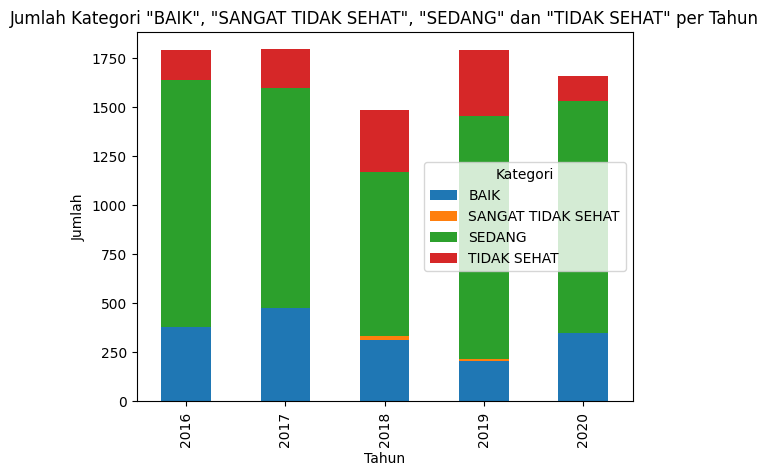

In [28]:
plt.figure(figsize=(16, 8))
jumlah_per_tahun.plot(kind='bar', stacked=True)
plt.title('Jumlah Kategori "BAIK", "SANGAT TIDAK SEHAT", "SEDANG" dan "TIDAK SEHAT" per Tahun')
plt.xlabel('Tahun')
plt.ylabel('Jumlah')
plt.legend(title='Kategori')

# Save the figure as PNG
plt.savefig('output_figure.png')

plt.show()

### Kesimpulan Visualisasi Kategori Kualitas Udara


Berdasarkan distribusi kategori kualitas udara di Provinsi DKI Jakarta dari tahun 2016 hingga 2020, dapat diambil beberapa kesimpulan:

- Kategori "BAIK":

Jumlah pengukuran kategori "BAIK" cenderung fluktuatif dari tahun ke tahun.
Pada tahun 2018, terdapat peningkatan jumlah pengukuran kategori "BAIK," tetapi kemudian mengalami penurunan pada tahun 2019.

- Kategori "SEDANG":

Jumlah pengukuran kategori "SEDANG" menunjukkan fluktuasi, dengan beberapa tahun mengalami peningkatan dan penurunan.
Pada tahun 2018, terdapat peningkatan yang signifikan dibandingkan tahun sebelumnya.

- Kategori "TIDAK SEHAT":

Jumlah pengukuran kategori "TIDAK SEHAT" juga mengalami fluktuasi dari tahun ke tahun.
Pada tahun 2018, terdapat peningkatan yang signifikan, kemudian mengalami penurunan pada tahun 2019.

- Kategori "SANGAT TIDAK SEHAT":

Jumlah pengukuran kategori "SANGAT TIDAK SEHAT" cenderung rendah dan terjadi pada tahun-tahun tertentu.

- Umum:

Secara umum, distribusi kategori kualitas udara di Provinsi DKI Jakarta menunjukkan fluktuasi yang dapat disebabkan oleh berbagai faktor, seperti cuaca, aktivitas manusia, dan kebijakan lingkungan.
Perlu dilakukan analisis lebih lanjut untuk memahami faktor-faktor yang mungkin mempengaruhi perubahan dalam distribusi kategori kualitas udara.

### 2.Bagaimana perbandingan jumlah kategori "BAIK", "SEDANG", "TIDAK SEHAT" dan "SANGAT TIDAK SEHAT" di antara stasiun pemantau kualitas udara di Provinsi DKI Jakarta?

Mengelompokkan data berdasarkan stasiun dan kategori, kemudian menghitung jumlah

In [29]:
grouped_data = df.groupby(['stasiun', 'categori']).size().reset_index(name='jumlah')

Menampilkan data

In [30]:
grouped_data

,stasiun,categori,jumlah
0,DKI1 (Bunderan HI),BAIK,542
1,DKI1 (Bunderan HI),SEDANG,1100
2,DKI1 (Bunderan HI),TIDAK SEHAT,54
3,DKI2 (Kelapa Gading),BAIK,329
4,DKI2 (Kelapa Gading),SANGAT TIDAK SEHAT,11
5,DKI2 (Kelapa Gading),SEDANG,1122
6,DKI2 (Kelapa Gading),TIDAK SEHAT,261
7,DKI3 (Jagakarsa),BAIK,248
8,DKI3 (Jagakarsa),SEDANG,1128
9,DKI3 (Jagakarsa),TIDAK SEHAT,308


Visualisasi bar plot untuk data yang telah dikelompokkan

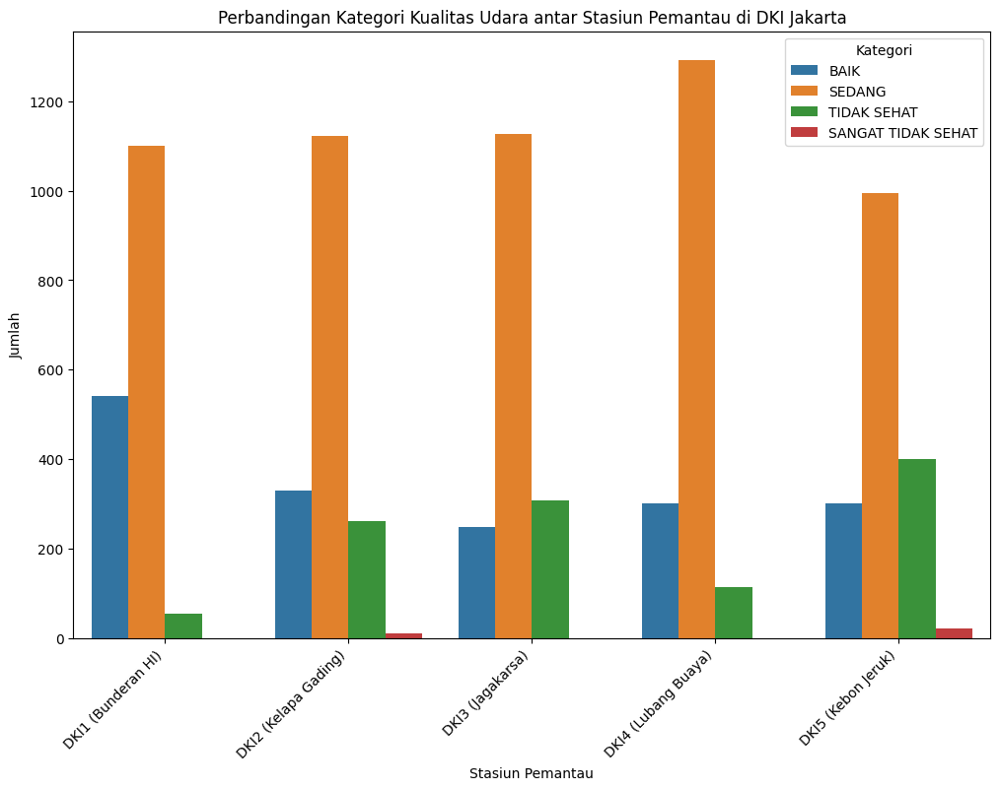

In [31]:
plt.figure(figsize=(12, 8))
sns.barplot(x='stasiun', y='jumlah', hue='categori', data=grouped_data)
plt.title('Perbandingan Kategori Kualitas Udara antar Stasiun Pemantau di DKI Jakarta')
plt.xlabel('Stasiun Pemantau')
plt.ylabel('Jumlah')
plt.legend(title='Kategori')
plt.xticks(rotation=45, ha='right')
plt.show()

### Kesimpulan Visualisasi Kualitas Udara Pada Setiap Stasiun

Berdasarkan data visualisasi kualitas udara di beberapa stasiun pemantau di Provinsi DKI Jakarta, berikut adalah kesimpulan:

1. DKI1 (Bunderan HI):

- Kategori "SEDANG" memiliki jumlah pengukuran tertinggi di DKI1 (Bunderan HI).
- Kategori "TIDAK SEHAT" memiliki jumlah yang rendah dibandingkan "SEDANG" dan "BAIK."

2. DKI2 (Kelapa Gading):

- DKI2 (Kelapa Gading) menunjukkan jumlah pengukuran tertinggi pada kategori "SEDANG."
- Terdapat pengukuran dalam kategori "SANGAT TIDAK SEHAT" yang relatif rendah.

3. DKI3 (Jagakarsa):

- Kategori "SEDANG" juga mendominasi di DKI3 (Jagakarsa).
- Jumlah pengukuran dalam kategori "TIDAK SEHAT" cukup tinggi.

4. DKI4 (Lubang Buaya):

- DKI4 (Lubang Buaya) memiliki jumlah pengukuran tertinggi dalam kategori "SEDANG."
- Kategori "TIDAK SEHAT" juga memiliki jumlah yang signifikan.

5. DKI5 (Kebon Jeruk):

- Kategori "SEDANG" mendominasi di DKI5 (Kebon Jeruk).
- Ada pengukuran dalam kategori "SANGAT TIDAK SEHAT" yang cukup signifikan.
- Kategori "TIDAK SEHAT" memiliki jumlah yang tinggi.

**Kesimpulan Umum:**

- Mayoritas stasiun pemantau memiliki jumlah pengukuran tertinggi dalam kategori "SEDANG," menunjukkan bahwa kualitas udara cenderung berada dalam tingkat sedang di berbagai stasiun.
- Beberapa stasiun, terutama DKI5 (Kebon Jeruk), menunjukkan tingkat pencemaran udara yang signifikan dengan pengukuran dalam kategori "SANGAT TIDAK SEHAT" dan "TIDAK SEHAT."
- Perlu dilakukan analisis lebih lanjut untuk memahami faktor-faktor yang mempengaruhi distribusi kategori kualitas udara di setiap stasiun.

### 3.Bagaimana persentase kontribusi masing-masing kategori "BAIK", "SEDANG", "TIDAK SEHAT" dan "SANGAT TIDAK SEHAT" terhadap total pengukuran kualitas udara?

Menghitung jumlah kategori kualitas udara

In [32]:
kategori_counts = df['categori'].value_counts()

Menampilkan data

In [33]:
kategori_counts

SEDANG                5637
BAIK                  1722
TIDAK SEHAT           1137
SANGAT TIDAK SEHAT      33
Name: categori, dtype: int64

Membuat pie chart

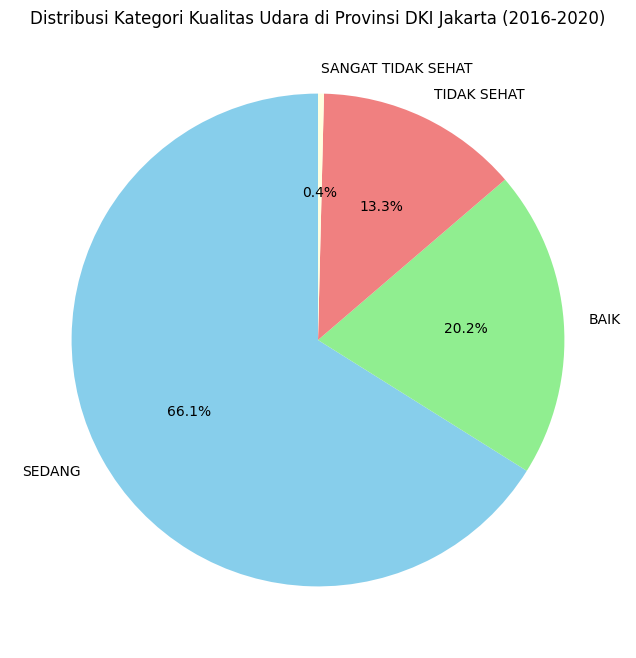

In [34]:
plt.figure(figsize=(8, 8))
plt.pie(kategori_counts, labels=kategori_counts.index, autopct='%1.1f%%', startangle=90, colors=['skyblue', 'lightgreen', 'lightcoral', 'lightyellow', 'lightpink'])
plt.title('Distribusi Kategori Kualitas Udara di Provinsi DKI Jakarta (2016-2020)')
plt.show()

### Kesimpulan dari piechart diatas

Berdasarkan visualisasi pie chart, berikut adalah kesimpulan:

1. Kategori "SEDANG":

- Menyumbang persentase terbesar dari total kategori kualitas udara (66.1%).
- Mayoritas pengukuran kualitas udara berada pada tingkat "SEDANG," menunjukkan bahwa kualitas udara cenderung moderat di berbagai waktu dan lokasi.

2. Kategori "BAIK":

- Menyumbang persentase sekitar 20.2% dari total kategori kualitas udara.
- Meskipun tidak mendominasi, kategori "BAIK" memberikan kontribusi yang signifikan, menunjukkan bahwa kualitas udara pada tingkat baik juga sering terjadi.

3. Kategori "TIDAK SEHAT":

- Menyumbang persentase sekitar 13.3% dari total kategori kualitas udara.
- Meskipun lebih rendah dibanding "SEDANG" dan "BAIK," kategori "TIDAK SEHAT" masih memiliki andil yang penting, menunjukkan adanya periode atau lokasi dengan kualitas udara yang tidak memadai.

4. Kategori "SANGAT TIDAK SEHAT":

- Menyumbang persentase yang sangat kecil, hanya sekitar 0.4% dari total.
- Meskipun jarang terjadi, adanya kategori "SANGAT TIDAK SEHAT" menunjukkan bahwa terdapat beberapa kasus dengan tingkat pencemaran udara yang sangat tinggi.

**Kesimpulan Umum:**

- Sebagian besar pengukuran menunjukkan kualitas udara dalam kategori "SEDANG," yang dapat diartikan sebagai tingkat pencemaran udara yang moderat.
- Kategori "BAIK" dan "TIDAK SEHAT" juga memberikan kontribusi yang signifikan, menunjukkan variasi kualitas udara dari baik hingga tidak sehat.
- Kategori "SANGAT TIDAK SEHAT" memiliki kontribusi yang sangat kecil, menunjukkan bahwa tingkat pencemaran udara yang sangat tinggi jarang terjadi.

### 4.Bagaimana persentase masing-masing kategori "BAIK", "SEDANG", "TIDAK SEHAT" dan "SANGAT TIDAK SEHAT" terhadap setiap stasiun?

Menghitung persentase kategori per stasiun

In [35]:
percentage_data = df.groupby(['stasiun', 'categori']).size().unstack().div(df.groupby('stasiun').size(), axis=0) * 100

menampilkan data yang suudah di hitung persentasenya

In [36]:
percentage_data

categori,BAIK,SANGAT TIDAK SEHAT,SEDANG,TIDAK SEHAT
stasiun,,,,
DKI1 (Bunderan HI),31.957547,NaN,64.858491,3.183962
DKI2 (Kelapa Gading),19.094602,0.638421,65.118979,15.147998
DKI3 (Jagakarsa),14.726841,NaN,66.983373,18.289786
DKI4 (Lubang Buaya),17.633275,NaN,75.688342,6.678383
DKI5 (Kebon Jeruk),17.568354,1.279814,57.882490,23.269343


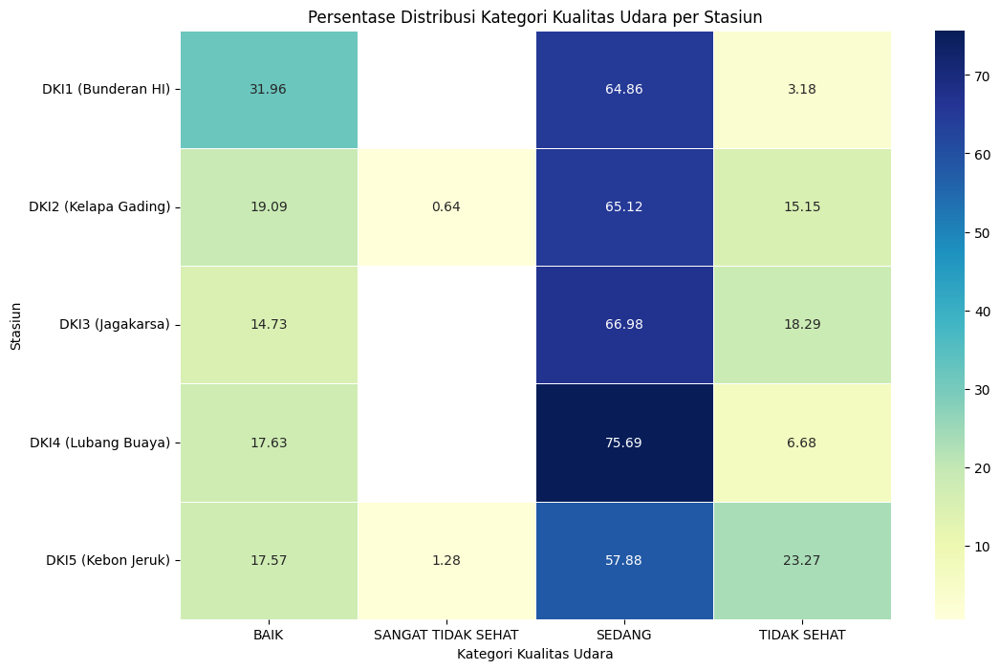

In [37]:
plt.figure(figsize=(12, 8))
sns.heatmap(percentage_data, annot=True, cmap='YlGnBu', fmt=".2f", linewidths=.5)
plt.title('Persentase Distribusi Kategori Kualitas Udara per Stasiun')
plt.xlabel('Kategori Kualitas Udara')
plt.ylabel('Stasiun')
plt.show()

### Kesimpulan dari piechart diatas

Berdasarkan visualisasi heatmap untuk persentase distribusi kategori kualitas udara di setiap stasiun, dapat diambil beberapa kesimpulan:

1. DKI1 (Bunderan HI):

   - Kategori "BAIK" mencakup sekitar 32% dari pengukuran.
   - Kategori "SEDANG" mendominasi dengan sekitar 65% dari pengukuran.
   - Kategori "TIDAK SEHAT" mencapai sekitar 3%.

2. DKI2 (Kelapa Gading):

   - Kategori "BAIK" sekitar 19%.
   - Kategori "SEDANG" merupakan mayoritas dengan sekitar 65% dari pengukuran.
   - Kategori "TIDAK SEHAT" dan "SANGAT TIDAK SEHAT" masing-masing mencakup sekitar 15% dan 0.64%.

3. DKI3 (Jagakarsa):

   - Kategori "BAIK" sekitar 15%.
   - Kategori "SEDANG" mendominasi dengan sekitar 67% dari pengukuran.
   - Kategori "TIDAK SEHAT" mencapai sekitar 18%.

4. DKI4 (Lubang Buaya):

   - Kategori "BAIK" mencakup sekitar 18% dari pengukuran.
   - Kategori "SEDANG" merupakan mayoritas dengan sekitar 76% dari pengukuran.
   - Kategori "TIDAK SEHAT" mencapai sekitar 7%.

5. DKI5 (Kebon Jeruk):
   - Kategori "BAIK" sekitar 18%.
   - Kategori "SEDANG" merupakan mayoritas dengan sekitar 58% dari pengukuran.
   - Kategori "TIDAK SEHAT" mencapai sekitar 23%.

Kesimpulannya, distribusi kategori kualitas udara bervariasi di setiap stasiun, dengan dominasi kategori "SEDANG" pada umumnya. Stasiun DKI3 (Jagakarsa) memiliki proporsi tertinggi kategori "SEDANG," sedangkan DKI4 (Lubang Buaya) memiliki proporsi tertinggi kategori "TIDAK SEHAT." Dengan informasi ini, dapat diidentifikasi stasiun-stasiun yang cenderung memiliki tingkat pencemaran udara yang lebih tinggi.


### 5.Stasiun mana yang memiliki kualitas udara "TIDAK SEHAT" ?

Mengelompokkan data berdasarkan stasiun dan menghitung jumlah kategori "TIDAK SEHAT"

In [38]:
dfts = df[df['categori'] == 'TIDAK SEHAT'].groupby('stasiun').size().reset_index(name='jumlah')

In [39]:
dfts

,stasiun,jumlah
0,DKI1 (Bunderan HI),54
1,DKI2 (Kelapa Gading),261
2,DKI3 (Jagakarsa),308
3,DKI4 (Lubang Buaya),114
4,DKI5 (Kebon Jeruk),400


Sorting stasiun berdasarkan jumlah "TIDAK SEHAT" secara descending

In [40]:
dfts = dfts.sort_values(by='jumlah', ascending=False)

In [41]:
dfts

,stasiun,jumlah
4,DKI5 (Kebon Jeruk),400
2,DKI3 (Jagakarsa),308
1,DKI2 (Kelapa Gading),261
3,DKI4 (Lubang Buaya),114
0,DKI1 (Bunderan HI),54


Membuat bar plot

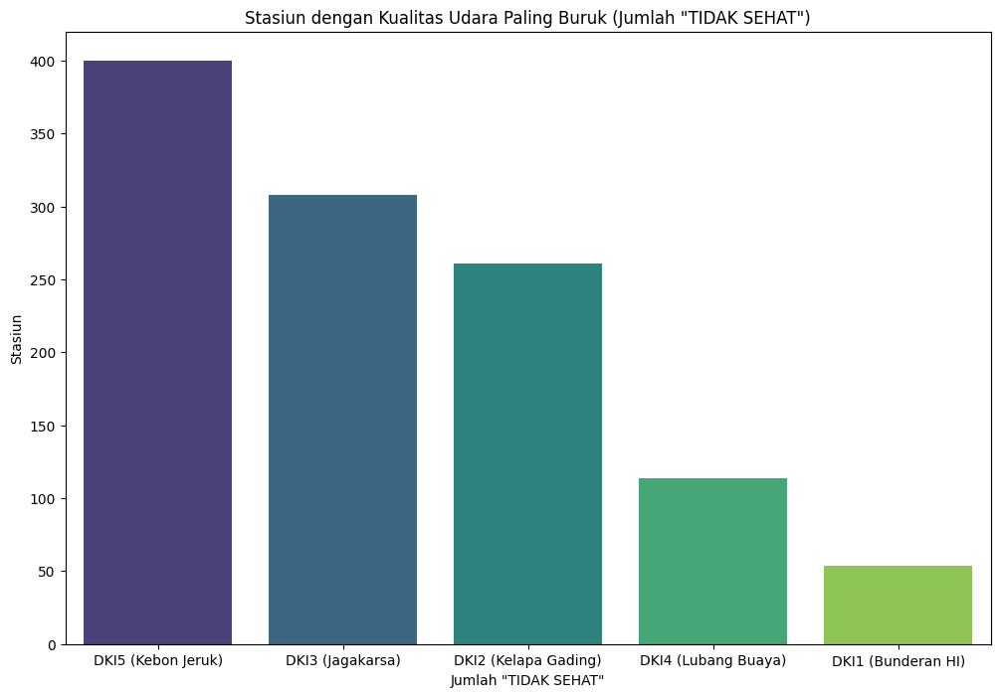

In [42]:
plt.figure(figsize=(12, 8))
sns.barplot(x='stasiun', y='jumlah', data=dfts, palette='viridis')
plt.title('Stasiun dengan Kualitas Udara Paling Buruk (Jumlah "TIDAK SEHAT")')
plt.xlabel('Jumlah "TIDAK SEHAT"')
plt.ylabel('Stasiun')
plt.show()

In [43]:
import folium

dki_map = folium.Map(location=[-6.196271, 106.822921], zoom_start=11)

# Add a marker for DKI1
folium.Marker(
    location=[-6.196271, 106.822921],
    popup='DKI1 (Bunderan HI)',
    icon=folium.Icon(color='red')
).add_to(dki_map)

# Add a circle with a radius of 3000 meters around DKI1
folium.Circle(
    location=[-6.196271, 106.822921],
    radius=3000,
    color='green',
    fill=True,
    fill_color='green',
    fill_opacity=0.2
).add_to(dki_map)

# Repeat the above steps for DKI2, DKI3, DKI4, and DKI5

# Add a marker for DKI2
folium.Marker(
    location=[-6.154454, 106.910845],
    popup='DKI2 (Kelapa Gading)',
    icon=folium.Icon(color='blue')
).add_to(dki_map)

# Add a circle with a radius of 3000 meters around DKI2
folium.Circle(
    location=[-6.154454, 106.910845],
    radius=3000,
    color='blue',
    fill=True,
    fill_color='blue',
    fill_opacity=0.2
).add_to(dki_map)

# Repeat the above steps for DKI3, DKI4, and DKI5

# Add a marker for DKI3
folium.Marker(
    location=[-6.356317, 106.804713],
    popup='DKI3 (Jagakarsa)',
    icon=folium.Icon(color='green')
).add_to(dki_map)

# Add a circle with a radius of 3000 meters around DKI3
folium.Circle(
    location=[-6.356317, 106.804713],
    radius=3000,
    color='red',
    fill=True,
    fill_color='red',
    fill_opacity=0.2
).add_to(dki_map)

# Repeat the above steps for DKI4 and DKI5

# Add a marker for DKI4
folium.Marker(
    location=[-6.290345, 106.908610],
    popup='DKI4 (Lubang Buaya)',
    icon=folium.Icon(color='orange')
).add_to(dki_map)

# Add a circle with a radius of 3000 meters around DKI4
folium.Circle(
    location=[-6.290345, 106.908610],
    radius=3000,
    color='green',
    fill=True,
    fill_color='green',
    fill_opacity=0.2
).add_to(dki_map)

# Add a marker for DKI5
folium.Marker(
    location=[-6.209225, 106.753437],
    popup='DKI5 (Kebon Jeruk)',
    icon=folium.Icon(color='purple')
).add_to(dki_map)

# Add a circle with a radius of 3000 meters around DKI5
folium.Circle(
    location=[-6.209225, 106.753437],
    radius=3000,
    color='red',
    fill=True,
    fill_color='red',
    fill_opacity=0.2
).add_to(dki_map)

# Display the map
dki_map


### Kesimpulan dari barchart diatas

Berdasarkan visualisasi stasiun yang memiliki kualitas udara paling buruk (jumlah "TIDAK SEHAT"), dapat disimpulkan bahwa:

- Stasiun DKI5 (Kebon Jeruk): Stasiun ini memiliki jumlah pengukuran "TIDAK SEHAT" tertinggi, yaitu sebanyak 400 kali.

- Stasiun DKI3 (Jagakarsa): Stasiun ini berada di peringkat kedua dengan jumlah pengukuran "TIDAK SEHAT" sebanyak 309 kali.

- Stasiun DKI2 (Kelapa Gading): Berada di peringkat ketiga dengan jumlah pengukuran "TIDAK SEHAT" sebanyak 262 kali.

- Stasiun DKI4 (Lubang Buaya): Menempati peringkat keempat dengan jumlah pengukuran "TIDAK SEHAT" sebanyak 115 kali.

- Stasiun DKI1 (Bunderan HI): Memiliki jumlah pengukuran "TIDAK SEHAT" terendah, yaitu sebanyak 54 kali.

Jadi, DKI5 (Kebon Jeruk) dapat dianggap sebagai stasiun yang memiliki kualitas udara paling buruk berdasarkan jumlah pengukuran "TIDAK SEHAT." Diperlukan analisis lebih lanjut untuk memahami faktor-faktor yang menyebabkan kondisi tersebut dan mengambil langkah-langkah untuk perbaikan.

### 6.Tahun berapa yang memiliki kualitas udara yang "BAIK"?

Mengelompokkan data berdasarkan tahun dan menghitung jumlah kategori "BAIK"

In [44]:
dfbaik = df[df['categori'] == 'BAIK'].groupby('tahun').size().reset_index(name='jumlah')

In [45]:
dfbaik

,tahun,jumlah
0,2016,379
1,2017,476
2,2018,311
3,2019,207
4,2020,349


Membuat bar plot

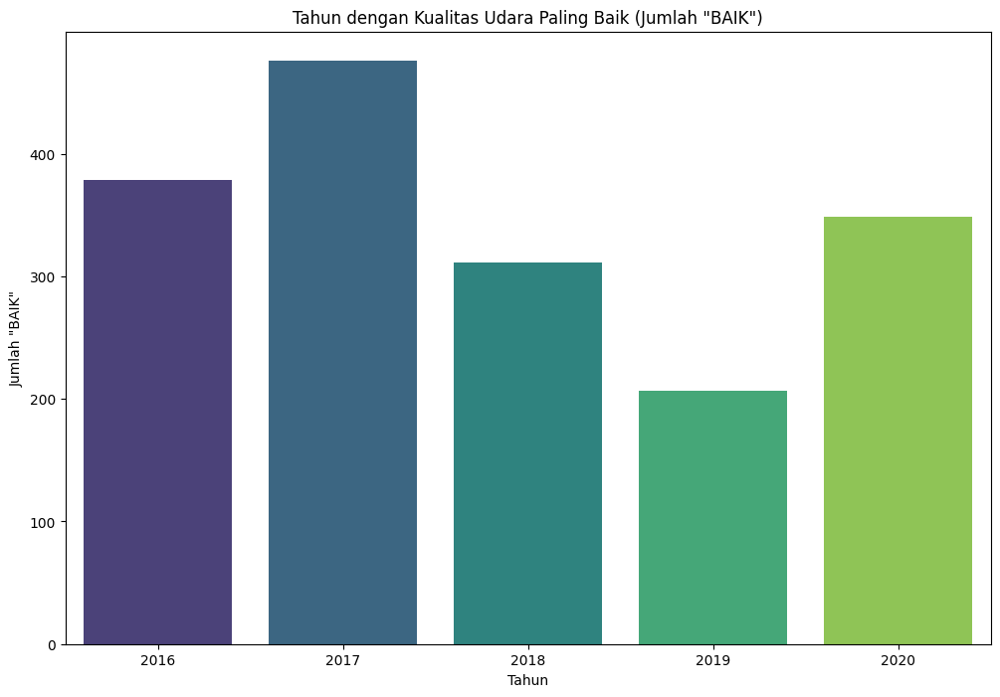

In [46]:
plt.figure(figsize=(12, 8))
sns.barplot(x='tahun', y='jumlah', data=dfbaik, palette='viridis')
plt.title('Tahun dengan Kualitas Udara Paling Baik (Jumlah "BAIK")')
plt.xlabel('Tahun')
plt.ylabel('Jumlah "BAIK"')
plt.show()

### Kesimpulan dari barchart diatas

Dari visualisasi di atas, kita dapat membuat beberapa kesimpulan:

- Tahun 2017 memiliki jumlah kategori "BAIK" terbanyak, yaitu sebanyak 476 pengukuran.
- Tahun 2016 memiliki jumlah kategori "BAIK" yang signifikan, namun lebih rendah dibandingkan dengan tahun 2017.
- Tahun 2021 memiliki jumlah kategori "BAIK" yang paling sedikit, yaitu hanya 78 pengukuran.
- Secara umum, terdapat fluktuasi dalam jumlah kategori "BAIK" dari tahun ke tahun, dengan peningkatan yang signifikan pada tahun 2017 dan penurunan pada tahun 2021.

Angka-angka di atas memberikan gambaran tentang variabilitas kategori "BAIK" dalam beberapa tahun terakhir.

In [47]:
mapping = {'SEDANG': 2, 'BAIK': 3, 'TIDAK SEHAT': 1, 'SANGAT TIDAK SEHAT': 0}
df['categori'] = df['categori'].replace(mapping)

df.head()

,tanggal,stasiun,pm10,so2,co,o3,no2,max,critical,categori,tahun
0,2016-01-01,DKI1 (Bunderan HI),59.0,19.0,27.0,31.0,1.0,59.0,PM10,2,2016
1,2016-01-02,DKI1 (Bunderan HI),52.0,19.0,26.0,33.0,2.0,52.0,PM10,2,2016
2,2016-01-03,DKI1 (Bunderan HI),44.0,19.0,26.0,36.0,2.0,44.0,PM10,3,2016
3,2016-01-04,DKI1 (Bunderan HI),58.0,21.0,26.0,46.0,5.0,58.0,PM10,2,2016
4,2016-01-05,DKI1 (Bunderan HI),70.0,19.0,26.0,41.0,4.0,70.0,PM10,2,2016


## Analisis Korelasi

Analisis korelasi merupakan salah satu teknik statistik yang digunakan untuk menganalisis hubungan antara dua variabel atau lebih yang bersifat kuantitatif. Bahwa adanya perubahan sebuah variabel disebabkan atau akan diikuti dengan perubahan variabel lain.

Mengambil beberapa kolom sample dari df untuk uji korelasi

In [48]:
df_cor = df.loc[:,['pm10','so2','co','o3','no2','max','critical','categori']]
df_cor.head()

,pm10,so2,co,o3,no2,max,critical,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,PM10,2
1,52.0,19.0,26.0,33.0,2.0,52.0,PM10,2
2,44.0,19.0,26.0,36.0,2.0,44.0,PM10,3
3,58.0,21.0,26.0,46.0,5.0,58.0,PM10,2
4,70.0,19.0,26.0,41.0,4.0,70.0,PM10,2


Melakukan proses label encoding

In [49]:
label_encoder = preprocessing.LabelEncoder()

df_category = df_cor.select_dtypes(include='object')
df_encode_cor = df_cor.copy()

for column in df_category.columns:
    df_encode_cor[column] = label_encoder.fit_transform(df_cor[column])

In [50]:
# Membuat fungsi heat_map dengan 2 parameter
# nama df adalah nama datasetnya, list kolom adalah list korelasi yang ingin di cek
def heat_map(nama_df,list_kolom): 
    df_heatmap = nama_df[list_kolom] #Memasukkan data kolom tersebut kedalam variabel baru
    plt.figure(figsize=(20,23)) #Mengatur ukuran
    
    #Membuat heat map dengan menampilkan nilai dari korelasi
    sns.heatmap(df_heatmap.corr(), 
                annot=True, 
                cmap="plasma", 
                linewidths=.5, 
                linecolor='black', 
                square=True) 

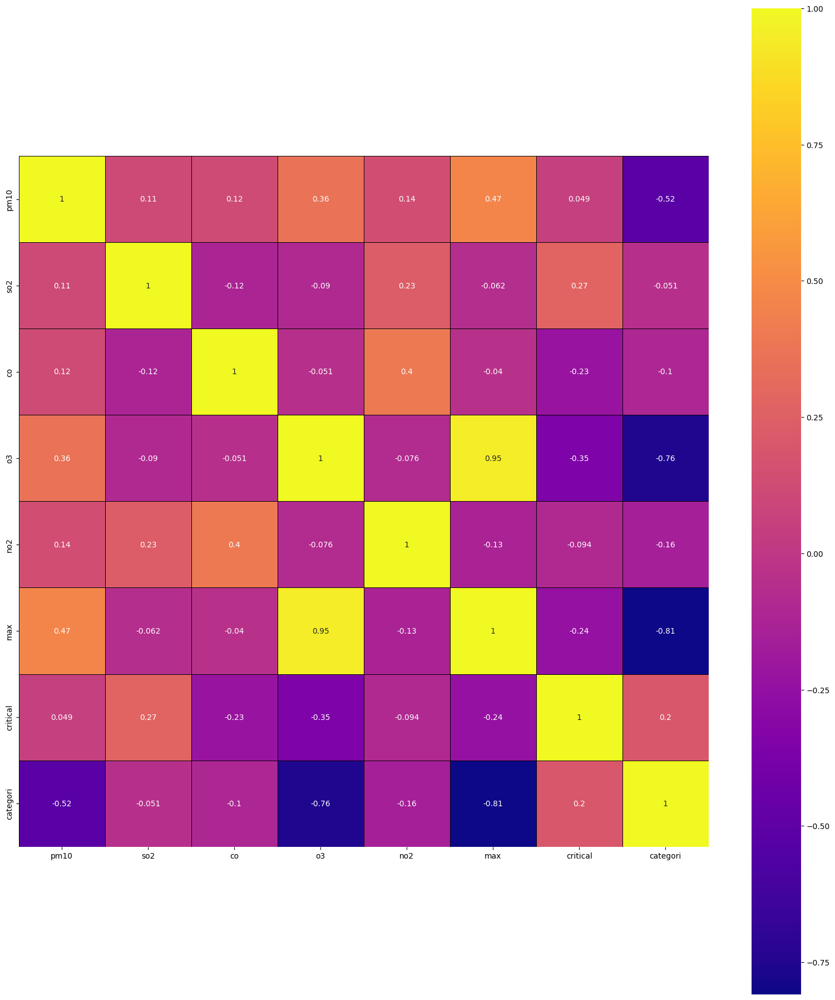

In [51]:
heat_map_modeling = ['pm10','so2','co','o3','no2','max','critical','categori']
heat_map(df_encode_cor,heat_map_modeling)

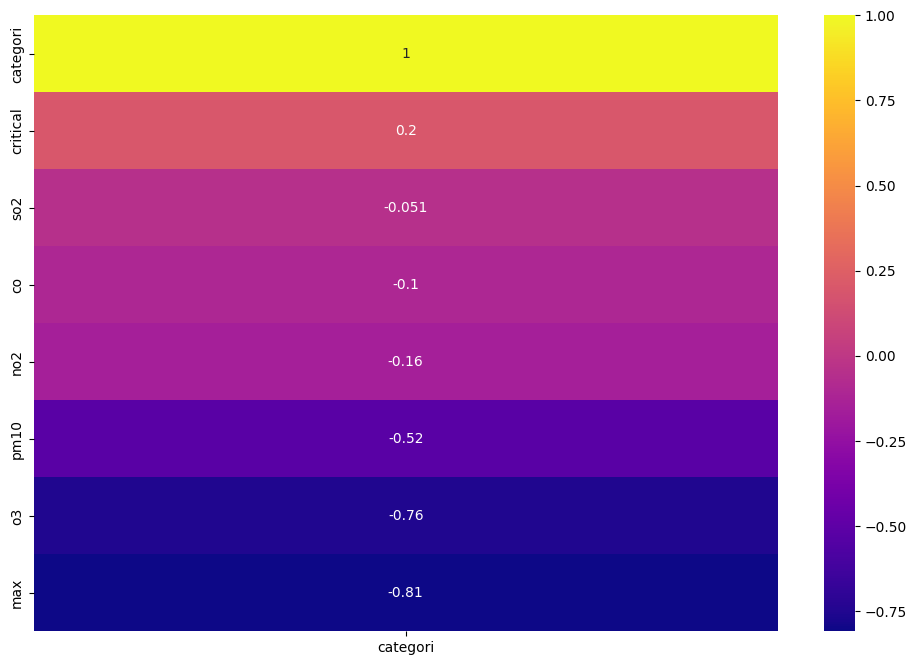

In [52]:
plt.figure(figsize=(12, 8))
corr = df_encode_cor.corr()[['categori']].sort_values(by='categori', ascending=False)
sns.heatmap(corr, annot=True, cmap="plasma");

**Keterangan:** 
Berdasarkan visualisasi heatmap diatas, dipilih beberapa kolom yang memiliki korelasi cukup tinggi dengan kolom `categori` yang kemudian nantinya digunakan untuk variabel X pada modelling. Kolom tersebut diantaranya adalah sebagai berikut:

1. `max` Merupakan nilai ukur paling tinggi dari seluruh parameter yang diukur dalam waktu yang sama. Dalam konteks ini, mungkin merujuk pada parameter kualitas udara tertentu, dengan korelasi sebesar 0.68
2. `o3` Merupakan parameter yang mengukur konsentrasi ozon di udara. Ozon dapat memiliki dampak kesehatan dan lingkungan, tergantung pada konsentrasinya, dengan korelasi sebesar 0.63
3. `pm10` Merupakan parameter yang mengukur konsentrasi partikel berukuran 10 mikrometer atau kurang di udara. Partikel ini dapat mencakup debu, asap, dan materi padat lainnya yang dapat mempengaruhi kualitas udara , dengan korelasi sebesar 0.58
4. `no2` Merupakan parameter yang mengukur konsentrasi nitrogen dioksida di udara. NO2 dapat berasal dari aktivitas pembakaran bahan bakar, seperti kendaraan bermotor dan industri , dengan korelasi sebesar 0.17
5. `co` Merupakan parameter yang mengukur konsentrasi karbon monoksida di udara. CO dapat berasal dari pembakaran bahan bakar fosil dan dapat berdampak negatif pada kesehatan manusia , dengan korelasi sebesar 0.12
6. `so2` Merupakan parameter yang mengukur konsentrasi dioksida belerang di udara. SO2 dapat berasal dari aktivitas pembakaran bahan bakar fosil dan proses industri tertentu , dengan korelasi sebesar 0.063

# Mencari Central Tendency & Measure of Spread 

1. Central Tendency merupakan nilai yang menunjukkan titik tengah dari suatu dataset untuk mengetahui dimana posisi banyak nilai data berkumpul di dalam distribusi. Nilai Mean, Median, dan Modus adalah ukuran Central Tendency yang paling umum digunakan. 
2. Measures of Spread didefinisikan sebagai cara untuk mendeskripsikan data dengan menjelaskan seberapa menyebar data kita. Cara yang sering digunakan adalah range, varian, dan standar deviasi.

Pada project ini, kami menggunakan kolom yang sudah dipilih dengan tipe data integer untuk dicari central tendency dan Measure of Spread nya.

Membuat variabel baru untuk menampung kolom numerik yang sudah dipilih

In [53]:
df_central = df.loc[:, ['pm10', 'so2', 'co', 'o3', 'max']]

Menampilkan 5 data teratas

In [54]:
df_central.head()

,pm10,so2,co,o3,max
0,59.0,19.0,27.0,31.0,59.0
1,52.0,19.0,26.0,33.0,52.0
2,44.0,19.0,26.0,36.0,44.0
3,58.0,21.0,26.0,46.0,58.0
4,70.0,19.0,26.0,41.0,70.0


Menghitung mean, median, modus, range, variansi, dan Standard Deviasi

In [55]:
for column in df_central:
    mean = df_central[column].mean()
    median = df_central[column].median()
    mode = df_central[column].mode()[0]
    min_value = df_central[column].min()
    max_value = df_central[column].max()
    range_value = max_value - min_value
    variance = df_central[column].var()
    std_dev = df_central[column].std()
    
#Print hasilnya
    print(f"Nama Kolom: {column}")
    print(f"Mean: {mean:.3f}")
    print(f"Median: {median:.3f}")
    print(f"Modus: {mode:.3f}")
    print(f"Range: {range_value:.3f}")
    print(f"Variansi: {variance:.3f}")
    print(f"Standard Deviasi: {std_dev:.3f}")
    print("  ")

Nama Kolom: pm10
Mean: 52.531
Median: 55.000
Modus: 55.000
Range: 132.000
Variansi: 263.679
Standard Deviasi: 16.238
  
Nama Kolom: so2
Mean: 21.460
Median: 20.000
Modus: 21.000
Range: 111.000
Variansi: 138.680
Standard Deviasi: 11.776
  
Nama Kolom: co
Mean: 20.013
Median: 17.000
Modus: 17.000
Range: 134.000
Variansi: 157.370
Standard Deviasi: 12.545
  
Nama Kolom: o3
Mean: 66.346
Median: 62.000
Modus: 54.000
Range: 240.000
Variansi: 1153.560
Standard Deviasi: 33.964
  
Nama Kolom: max
Mean: 71.413
Median: 67.000
Modus: 65.000
Range: 242.000
Variansi: 954.486
Standard Deviasi: 30.895
  


# Cardinality
Cardinality / Kardinalitas adalah ukuran keunikan data pada kolom tertentu dari suatu table database. Tujuan kita adalah mengurangi cardinality untuk membuat model yang lebih konsisten dan tidak over-fit. Kita memastikan semua label unik yang ada pernah dilihat model saat training.

In [56]:
df_card = df.loc[:,['pm10','so2','co','o3','no2','max','critical','categori']]
df_card.head()

,pm10,so2,co,o3,no2,max,critical,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,PM10,2
1,52.0,19.0,26.0,33.0,2.0,52.0,PM10,2
2,44.0,19.0,26.0,36.0,2.0,44.0,PM10,3
3,58.0,21.0,26.0,46.0,5.0,58.0,PM10,2
4,70.0,19.0,26.0,41.0,4.0,70.0,PM10,2


In [57]:
cardinalities = df_card.nunique()
cardinalities

pm10        109
so2         103
co          105
o3          215
no2          98
max         215
critical      6
categori      4
dtype: int64

Dari hasil kardinalitas (jumlah nilai unik) untuk setiap kolom pada DataFrame `df_card`, kita dapat membuat kesimpulan sebagai berikut:

- **pm10:** Terdapat 109 nilai unik untuk parameter Partikulat (pm10). Variabel ini mencatat variasi yang cukup besar di tingkat partikulat dengan nilai yang berbeda-beda.

- **so2:** Terdapat 103 nilai unik untuk parameter Sulfida (so2). Variabel ini mencatat variasi yang cukup besar di tingkat sulfida dengan nilai yang berbeda-beda.

- **co:** Terdapat 105 nilai unik untuk parameter Carbon Monoksida (co). Variabel ini mencatat variasi yang cukup besar di tingkat karbon monoksida dengan nilai yang berbeda-beda.

- **o3:** Terdapat 215 nilai unik untuk parameter Ozon (o3). Variabel ini mencatat variasi yang cukup besar di tingkat ozon dengan nilai yang berbeda-beda.

- **no2:** Terdapat 98 nilai unik untuk parameter Nitrogen Dioksida (no2). Variabel ini mencatat variasi yang cukup besar di tingkat nitrogen dioksida dengan nilai yang berbeda-beda.

- **max:** Terdapat 215 nilai unik untuk nilai ukur paling tinggi dari seluruh parameter yang diukur dalam waktu yang sama. Variabel ini mencatat variasi yang cukup besar di tingkat nilai ukur maksimum dengan nilai yang berbeda-beda.

- **critical:** Terdapat 6 nilai unik untuk parameter yang hasil pengukurannya paling tinggi. Variabel ini merupakan kategori yang cukup terbatas.

- **categori:** Terdapat 4 nilai unik untuk kategori hasil perhitungan indeks standar pencemaran udara. Variabel ini mencakup kategori kualitas udara dan tergolong dalam variabel kategoris yang umumnya tidak terlalu banyak nilai unik.


# Feature Scaling
Feature scaling adalah teknik untuk membuat skala data setiap fitur menjadi sama. Pada project ini, kami menggunakan MinMax Scaler yang melakukan transform feature dengan mengubah setiap data ke range tertentu antara 0-1.

In [58]:
scaler = MinMaxScaler()

df_new = df_encode_cor.copy()
df_model = df_new.loc[:,['pm10','so2','co','o3','no2','max','categori']]

df_model[['pm10','so2','co','o3','no2','max']]

,pm10,so2,co,o3,no2,max
0,59.0,19.0,27.0,31.0,1.0,59.0
1,52.0,19.0,26.0,33.0,2.0,52.0
2,44.0,19.0,26.0,36.0,2.0,44.0
3,58.0,21.0,26.0,46.0,5.0,58.0
4,70.0,19.0,26.0,41.0,4.0,70.0
5,69.0,19.0,26.0,19.0,4.0,69.0
6,58.0,19.0,26.0,25.0,3.0,58.0
7,46.0,24.0,26.0,54.0,3.0,46.0
8,51.0,32.0,26.0,54.0,2.0,51.0
9,59.0,39.0,26.0,43.0,3.0,59.0


In [59]:
df_model.head()

,pm10,so2,co,o3,no2,max,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,2
1,52.0,19.0,26.0,33.0,2.0,52.0,2
2,44.0,19.0,26.0,36.0,2.0,44.0,3
3,58.0,21.0,26.0,46.0,5.0,58.0,2
4,70.0,19.0,26.0,41.0,4.0,70.0,2


# Analisis

# Kondisi 1 
Memilih kolom dengan korelasi paling tinggi berdasarkan analisis korelasi yang telah dilakukan. Kolom yang dipilih sudah melalui proses encoding dan feature scaling.

In [60]:
df_kondisi = df_model.loc[:,['pm10','so2','co','o3','no2','max','categori']]
df_kondisi.head()

,pm10,so2,co,o3,no2,max,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,2
1,52.0,19.0,26.0,33.0,2.0,52.0,2
2,44.0,19.0,26.0,36.0,2.0,44.0,3
3,58.0,21.0,26.0,46.0,5.0,58.0,2
4,70.0,19.0,26.0,41.0,4.0,70.0,2


In [61]:
df_kondisi['categori'].value_counts()

2    5637
3    1722
1    1137
0      33
Name: categori, dtype: int64

# Modeling

## 1.Logistic Regression

In [62]:
lr_model = LogisticRegression()

In [63]:
x = df_kondisi.drop(columns=['categori'],axis=1).values
y = df_kondisi['categori'].values

x_train1, x_test1, y_train1, y_test1 = train_test_split(x, y, test_size=0.3, random_state=0)

In [64]:
# model training
lr_model.fit(x_train1, y_train1.ravel())

LogisticRegression()

In [65]:
y_pred1 = lr_model.predict(x_test1)

In [66]:
# Mengevaluasi model data train
lr_predict_train = lr_model.predict(x_train1)

print("Accuracy :", metrics.accuracy_score(y_train1, lr_predict_train))

Accuracy : 0.8425460636515912


In [67]:
# Mengevaluasi model data test
lr_predict_test = lr_model.predict(x_test1)

print("Accuracy :", metrics.accuracy_score(y_test1, lr_predict_test))

Accuracy : 0.8647909339585775


In [68]:
# confusion matrix
print("Confusion Matrix")
print("{0}".format(metrics.confusion_matrix(y_test1, lr_predict_test)))

Confusion Matrix
[[   3    7    0    0]
 [   4  231  125    0]
 [   0   61 1616   12]
 [   0    3  134  363]]


In [69]:
# Classification report
print("Classification Report :")
print(metrics.classification_report(y_test1, lr_predict_test))

Classification Report :
              precision    recall  f1-score   support

           0       0.43      0.30      0.35        10
           1       0.76      0.64      0.70       360
           2       0.86      0.96      0.91      1689
           3       0.97      0.73      0.83       500

    accuracy                           0.86      2559
   macro avg       0.76      0.66      0.70      2559
weighted avg       0.87      0.86      0.86      2559



In [70]:
y_test1

array([2, 2, 3, ..., 2, 2, 3], dtype=int64)

In [71]:
y_pred1

array([2, 2, 3, ..., 2, 2, 3], dtype=int64)

In [72]:
kondisi = pd.DataFrame({'Actual':y_test1, 'Predicted':y_pred1})
kondisi.head()

,Actual,Predicted
0,2,2
1,2,2
2,3,3
3,2,2
4,1,2


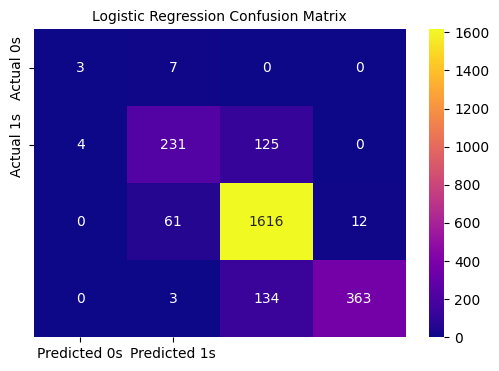

In [73]:
cm = confusion_matrix(y_test1, y_pred1)

fig, ax = plt.subplots(figsize=(6,4))
ax.set_title("Logistic Regression Confusion Matrix", fontsize=10)
sns.heatmap(cm, annot=True, cmap='plasma', fmt='g', 
            xticklabels = ('Predicted 0s','Predicted 1s'), 
            yticklabels = ('Actual 0s','Actual 1s'));

## 2. Support Vector Machine

In [74]:
svmcla_model = OneVsRestClassifier(BaggingClassifier(SVC(C=10, kernel='rbf', random_state=9, probability=True), n_jobs=-1))

In [75]:
x2 = df_kondisi.drop(['categori'], axis = 1)
y2 = df_kondisi['categori']

# Memisahkan data menjadi data training dan data testing
x_train2, x_test2, y_train2, y_test2 = train_test_split(x2, y2, test_size = 0.3, random_state=0)

In [76]:
# model training
svmcla_model.fit(x_train2, y_train2)

OneVsRestClassifier(estimator=BaggingClassifier(estimator=SVC(C=10,
                                                              probability=True,
                                                              random_state=9),
                                                n_jobs=-1))

In [77]:
y_pred2 = svmcla_model.predict(x_test2)

In [78]:
# Mengevaluasi model data train
svm_predict_train = svmcla_model.predict(x_train2)

print("Accuracy :", metrics.accuracy_score(y_train2, svm_predict_train))

Accuracy : 0.9948073701842546


In [79]:
# Mengevaluasi model data test
svm_predict_test = svmcla_model.predict(x_test2)

print("Accuracy :", metrics.accuracy_score(y_test2, svm_predict_test))

Accuracy : 0.9957014458772958


In [80]:
# confusion matrix
print("Confusion Matrix :")
print("{0}".format(metrics.confusion_matrix(y_test2, svm_predict_test)))

Confusion Matrix :
[[  10    0    0    0]
 [   0  357    3    0]
 [   0    2 1687    0]
 [   0    0    6  494]]


In [81]:
# Classification report
print("Classification Report :")
print(metrics.classification_report(y_test2, svm_predict_test))

Classification Report :
              precision    recall  f1-score   support

           0       1.00      1.00      1.00        10
           1       0.99      0.99      0.99       360
           2       0.99      1.00      1.00      1689
           3       1.00      0.99      0.99       500

    accuracy                           1.00      2559
   macro avg       1.00      0.99      1.00      2559
weighted avg       1.00      1.00      1.00      2559



In [82]:
y_pred2

array([2, 2, 3, ..., 2, 2, 3], dtype=int64)

In [83]:
kondisi2 = pd.DataFrame({'Actual':y_test2, 'Predicted':y_pred2})
kondisi2.head()

,Actual,Predicted
725,2,2
1589,2,2
8503,3,3
233,2,2
8208,1,1


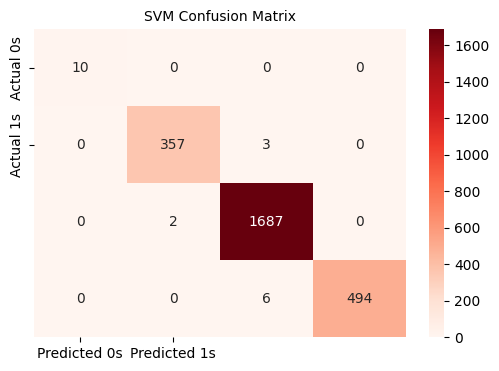

In [84]:
cm2 = confusion_matrix(y_test2, y_pred2)

fig, ax = plt.subplots(figsize=(6,4))
ax.set_title("SVM Confusion Matrix", fontsize=10)
sns.heatmap(cm2, annot=True, cmap='Reds', fmt='g', 
            xticklabels = ('Predicted 0s','Predicted 1s'), 
            yticklabels = ('Actual 0s','Actual 1s'));

# Model Inference

In [85]:
input_data = np.array([[65.0,13.0,26.0,56.0,10.0,65.0]])
prediction = svmcla_model.predict(input_data)
print("prediksi kualitas udara :", prediction)

prediksi kualitas udara : [2]


In [86]:
input_data = np.array([[15.0,16.0,15.0,101.0,8.0,101.0]])
prediction = lr_model.predict(input_data)
print("prediksi kualitas udara :", prediction)

prediksi kualitas udara : [1]


In [87]:
model_inference = {'pm10': [52.0, 44.0, 18.0, 22.0],
                   'so2': [19.0, 19.0, 32.0, 33.0],  
                   'co': [26.0, 26.0, 4.0, 5.0],
                   'o3': [33.0, 36.0, 41.0, 35.0],
                   'no2': [2.0, 2.0, 9.0, 3.0],
                   'max': [59.0, 44.0, 41.0, 35.0],
                  }
model_inference = pd.DataFrame(model_inference)


In [88]:
model_inference

,pm10,so2,co,o3,no2,max
0,52.0,19.0,26.0,33.0,2.0,59.0
1,44.0,19.0,26.0,36.0,2.0,44.0
2,18.0,32.0,4.0,41.0,9.0,41.0
3,22.0,33.0,5.0,35.0,3.0,35.0


In [89]:
prediksi = svmcla_model.predict(model_inference)
prediksi

array([2, 3, 3, 3], dtype=int64)

In [90]:
prediksi = lr_model.predict(model_inference)
prediksi

array([2, 3, 3, 3], dtype=int64)

In [91]:
df_model.head()

,pm10,so2,co,o3,no2,max,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,2
1,52.0,19.0,26.0,33.0,2.0,52.0,2
2,44.0,19.0,26.0,36.0,2.0,44.0,3
3,58.0,21.0,26.0,46.0,5.0,58.0,2
4,70.0,19.0,26.0,41.0,4.0,70.0,2


In [92]:
df_model.tail()

,pm10,so2,co,o3,no2,max,categori
8524,18.0,32.0,4.0,41.0,9.0,41.0,3
8525,22.0,33.0,5.0,35.0,3.0,35.0,3
8526,15.0,28.0,4.0,27.0,9.0,28.0,3
8527,16.0,7.0,3.0,21.0,2.0,21.0,3
8528,18.0,13.0,6.0,24.0,3.0,24.0,3


## Perbandingan Model

,Model,Accuracy,Precision,Recall,F1 Score
0,Logistic Regression,0.864791,0.867270,0.864791,0.860214
1,SVM,0.994920,0.994936,0.994920,0.994916


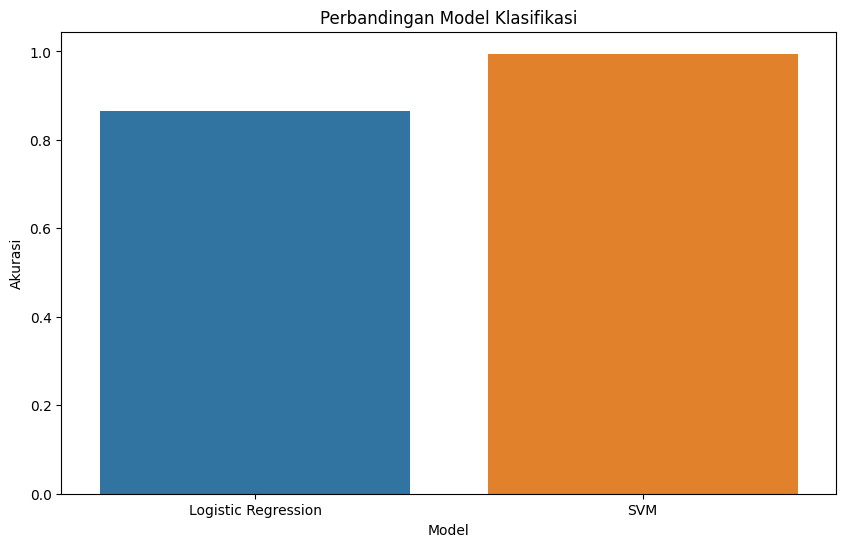

In [93]:
models = [('Logistic Regression', lr_model),
          ('SVM', svmcla_model),
         ]

x = df_kondisi.drop(columns=['categori'], axis=1).values
y = df_kondisi['categori'].values
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=0)

def evaluate_model(model, x_test, y_test):
    y_pred = model.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, average='weighted') 
    recall = recall_score(y_test, y_pred, average='weighted')  
    f1 = f1_score(y_test, y_pred, average='weighted')  
    return accuracy, precision, recall, f1

results = []
for name, model in models:
    model.fit(x_train, y_train)
    accuracy, precision, recall, f1 = evaluate_model(model, x_test, y_test)
    results.append([name, accuracy, precision, recall, f1])

results_df = pd.DataFrame(results, columns=['Model', 'Accuracy', 'Precision', 'Recall', 'F1 Score'])
display(results_df)

plt.figure(figsize=(10, 6))
sns.color_palette("Set2")
sns.barplot(x='Model', y='Accuracy', data=results_df)
plt.title('Perbandingan Model Klasifikasi')
plt.xticks(rotation=0)
plt.ylabel('Akurasi')
plt.show()

In [94]:
df_model

,pm10,so2,co,o3,no2,max,categori
0,59.0,19.0,27.0,31.0,1.0,59.0,2
1,52.0,19.0,26.0,33.0,2.0,52.0,2
2,44.0,19.0,26.0,36.0,2.0,44.0,3
3,58.0,21.0,26.0,46.0,5.0,58.0,2
4,70.0,19.0,26.0,41.0,4.0,70.0,2
5,69.0,19.0,26.0,19.0,4.0,69.0,2
6,58.0,19.0,26.0,25.0,3.0,58.0,2
7,46.0,24.0,26.0,54.0,3.0,46.0,3
8,51.0,32.0,26.0,54.0,2.0,51.0,2
9,59.0,39.0,26.0,43.0,3.0,59.0,2


In [95]:
import pickle

filename = 'udara_svm.sav'
pickle.dump(svmcla_model, open(filename,'wb'))

In [96]:
import pickle

# Assuming 'model' is your trained machine learning model
with open('udara_svm.pkl', 'wb') as model_file:
    pickle.dump(model, model_file)

In [97]:
df_model['categori'].value_counts()

2    5637
3    1722
1    1137
0      33
Name: categori, dtype: int64

In [98]:
df['categori'].value_counts()

2    5637
3    1722
1    1137
0      33
Name: categori, dtype: int64

In [99]:
df.to_csv('D:/Kuliah/Semester 7/Internship/Project Kualitas Udara/Dataset/KUALITAS UDARA/qualityudaradf.csv', index=False)


In [100]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8529 entries, 0 to 8528
Data columns (total 11 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   tanggal   8529 non-null   datetime64[ns]
 1   stasiun   8529 non-null   object        
 2   pm10      8529 non-null   float64       
 3   so2       8529 non-null   float64       
 4   co        8529 non-null   float64       
 5   o3        8529 non-null   float64       
 6   no2       8529 non-null   float64       
 7   max       8529 non-null   float64       
 8   critical  8529 non-null   object        
 9   categori  8529 non-null   int64         
 10  tahun     8529 non-null   int64         
dtypes: datetime64[ns](1), float64(6), int64(2), object(2)
memory usage: 733.1+ KB


In [101]:
df_db = df.loc[:,['pm10','so2','co','o3','no2','max','categori']]

In [102]:
df_db.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8529 entries, 0 to 8528
Data columns (total 7 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   pm10      8529 non-null   float64
 1   so2       8529 non-null   float64
 2   co        8529 non-null   float64
 3   o3        8529 non-null   float64
 4   no2       8529 non-null   float64
 5   max       8529 non-null   float64
 6   categori  8529 non-null   int64  
dtypes: float64(6), int64(1)
memory usage: 466.6 KB


In [103]:
df_db['categori'].value_counts()

2    5637
3    1722
1    1137
0      33
Name: categori, dtype: int64

In [104]:
df['stasiun'].value_counts()

DKI2 (Kelapa Gading)    1723
DKI5 (Kebon Jeruk)      1719
DKI4 (Lubang Buaya)     1707
DKI1 (Bunderan HI)      1696
DKI3 (Jagakarsa)        1684
Name: stasiun, dtype: int64

In [105]:
df.shape

(8529, 11)

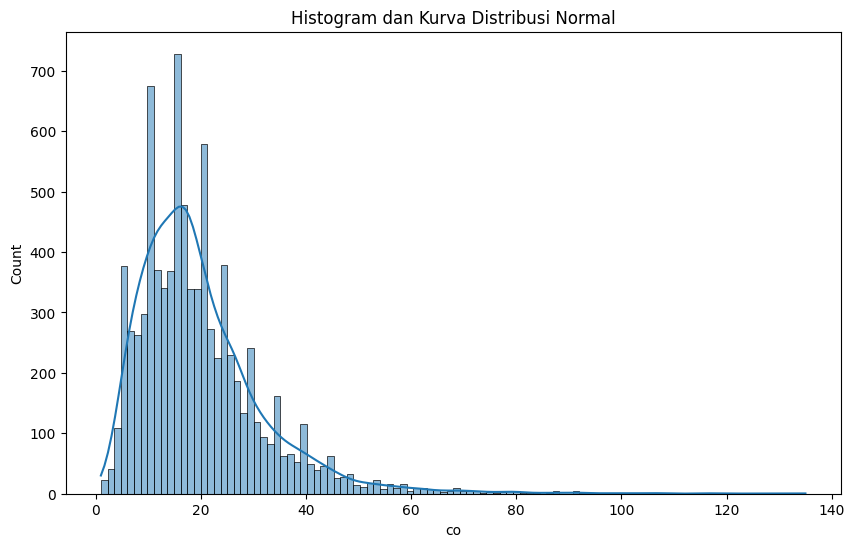

In [111]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
sns.histplot(df['co'], kde=True)
plt.title('Histogram dan Kurva Distribusi Normal')
plt.show()


<Figure size 1000x600 with 0 Axes>

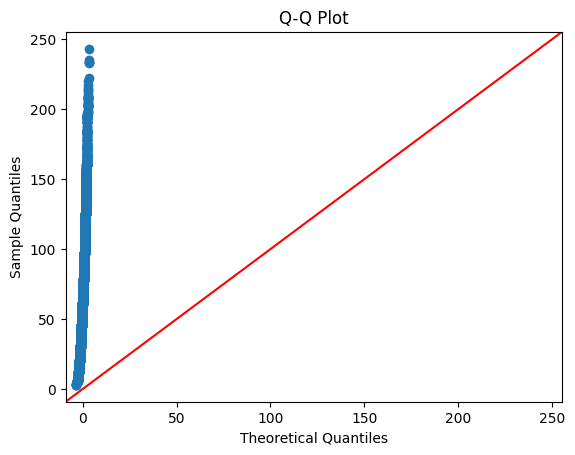

In [120]:
import statsmodels.api as sm

plt.figure(figsize=(10, 6))
sm.qqplot(df['o3'], line='45')
plt.title('Q-Q Plot')
plt.show()


In [116]:
from scipy.stats import shapiro

_, p_value = shapiro(df['pm10'])
print(f"Nilai p dari uji Shapiro-Wilk: {p_value}")


Nilai p dari uji Shapiro-Wilk: 1.5564368280521403e-34
